In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import zipfile
import os
!pip show tensorflow
!pip show keras

Name: tensorflow
Version: 2.17.1
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /usr/local/lib/python3.11/dist-packages
Requires: absl-py, astunparse, flatbuffers, gast, google-pasta, grpcio, h5py, keras, libclang, ml-dtypes, numpy, opt-einsum, packaging, protobuf, requests, setuptools, six, tensorboard, tensorflow-io-gcs-filesystem, termcolor, typing-extensions, wrapt
Required-by: dopamine_rl, tf_keras
Name: keras
Version: 3.5.0
Summary: Multi-backend Keras.
Home-page: https://github.com/keras-team/keras
Author: Keras team
Author-email: keras-users@googlegroups.com
License: Apache License 2.0
Location: /usr/local/lib/python3.11/dist-packages
Requires: absl-py, h5py, ml-dtypes, namex, numpy, optree, packaging, rich
Required-by: tensorflow


In [ ]:
# Specify the source ZIP file and the destination folder
source_zip_path =  "/content/drive/MyDrive/PlantProject/PlantData.zip"


destination_folder =  "/content/drive/MyDrive/PlantProject"


In [ ]:
# Unzip the file into the specified folder
!unzip $source_zip_path -d $destination_folder

Archive:  /content/drive/MyDrive/PlantProject/PlantData.zip
replace /content/drive/MyDrive/PlantProject/NayaData/input/test/Corn___Common_rust/Corn___Common_rust_original_image (1054).JPG_337d0a08-ff9c-4096-b30e-8b3ad82cf003.JPG? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.layers import Dense,Flatten,Conv2D,MaxPooling2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers  import Concatenate
from tensorflow.keras.layers import AveragePooling2D, Dropout, Input, BatchNormalization
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import classification_report, confusion_matrix
from PIL import Image
from tqdm import tqdm
import urllib
from tensorflow.keras.preprocessing import image
from sklearn.metrics import precision_recall_curve,roc_curve, auc
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt
import os
from sklearn.metrics import log_loss, brier_score_loss
from sklearn.metrics import cohen_kappa_score
import matplotlib.cm as cm
from sklearn.metrics import matthews_corrcoef
import pandas as pd
import seaborn as sns
import numpy as np
import cv2
from sklearn.preprocessing import label_binarize
from sklearn.metrics import average_precision_score
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.layers import Activation, BatchNormalization, Conv2D, Dense, Dropout, Flatten, MaxPooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.regularizers import l2

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Dense
from tensorflow.keras.applications import VGG19
from tensorflow.keras.optimizers import Adam




%matplotlib inline

In [ ]:
image_path = '/content/drive/MyDrive/PlantProject/PlantDatavgg/input/train/'

In [ ]:
train_image_path = '/content/drive/MyDrive/PlantProject/PlantDatavgg/input/train/'
valid_image_path = '/content/drive/MyDrive/PlantProject/PlantDatavgg/input/valid/'

In [ ]:
test_image_path='/content/drive/MyDrive/PlantProject/PlantDatavgg/input/test/'

In [ ]:
#CLASS NAME
class_names = os.listdir(image_path)
print(class_names)

['Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Corn___Common_rust', 'Corn___healthy', 'Corn___Northern_Leaf_Blight', 'Not_a_Leaf', 'Potato___Early_blight', 'Potato___healthy', 'Potato___Late_blight']


In [ ]:
from PIL import Image

def create_data_frame(path):
    list_plant=[]
    list_category=[]
    list_disease=[]
    list_path=[]
    list_plant_category=[]
    list_image_size=[]
    list_image_type=[]
    list_size=[]

    for path,directory,files in os.walk(path,topdown=False):
        for name in files:
            plant_category=category=path.split("/")[-1]
            plant=plant_category.split("___")[0]
            category=plant_category.split("___")[-1]
            disease=0 if category=="healthy" else 1
            full_path=path+"/"+name
            image_type=name.split(".")[1]
            size=os.path.getsize(full_path)
            with Image.open(full_path) as images:
                width,height=images.size
            list_plant.append(plant)
            list_category.append(category)
            list_disease.append(disease)
            list_path.append(full_path)
            list_plant_category.append(plant_category)
            list_image_size.append(str(width)+"x"+str(height))
            list_image_type.append(image_type)
            list_size.append(size)




    data_info=pd.DataFrame.from_dict({"Plant":list_plant,"Category":list_category,"Disease":list_disease,
                           "Path":list_path,"Plant_Category":list_plant_category,"Image_size":list_image_size,"Image_type":list_image_type,"Size":list_size},orient="columns")

    image_count_info=pd.DataFrame(data_info.groupby(["Plant","Category","Plant_Category"]).size())
    image_count_info.rename(columns={0:"nb"},inplace=True)
    image_count_info=image_count_info.reset_index()
    return data_info,image_count_info

train_data_info,train_data_count=create_data_frame(train_image_path)
valid_data_info,valid_data_count=create_data_frame(valid_image_path)

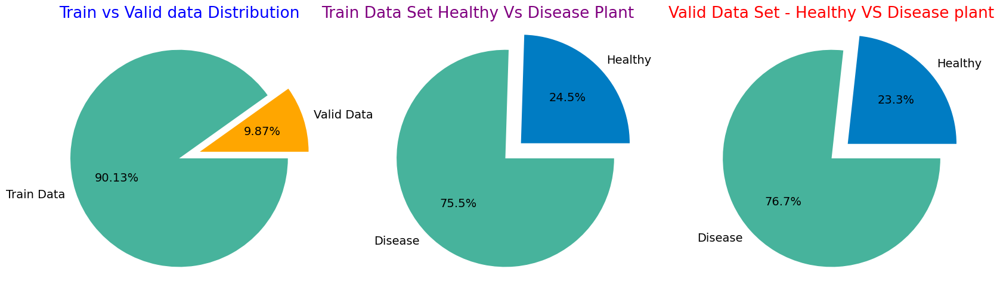

In [ ]:
def image_information(data_set_info):
    plt.rcParams["font.size"]=14
    plt.pie([data_set_info.nb[data_set_info.Category=="healthy"].sum(),data_set_info.nb[data_set_info.Category!="health"].sum()],labels=["Healthy","Disease"],autopct=lambda x:str(round(x,1))+"%",colors=["#007CC3","#47B39C"],shadow=False,explode=(0.20,0))


plt.figure(figsize=(20,20))
plt.subplot(1,3,1)
plt.title("Train vs Valid data Distribution",fontsize=19,color="Blue")
plt.rcParams["font.size"]=14

# image_information(valid_data_count)
plt.pie([valid_data_count.nb.sum(),train_data_count.nb.sum()],labels=["Valid Data","Train Data"],autopct=lambda x: str(round(x,2))+"%",colors=["#FFA600","#47B39C"],shadow=False,explode=(0.20,0))
plt.subplot(1,3,2)
plt.title("Train Data Set Healthy Vs Disease Plant "        "          "  ,fontsize=19,color="purple")
image_information(train_data_count)
plt.subplot(1,3,3)
plt.title('Valid Data Set - Healthy VS Disease plant', fontsize=19,color="red")
image_information(valid_data_count)

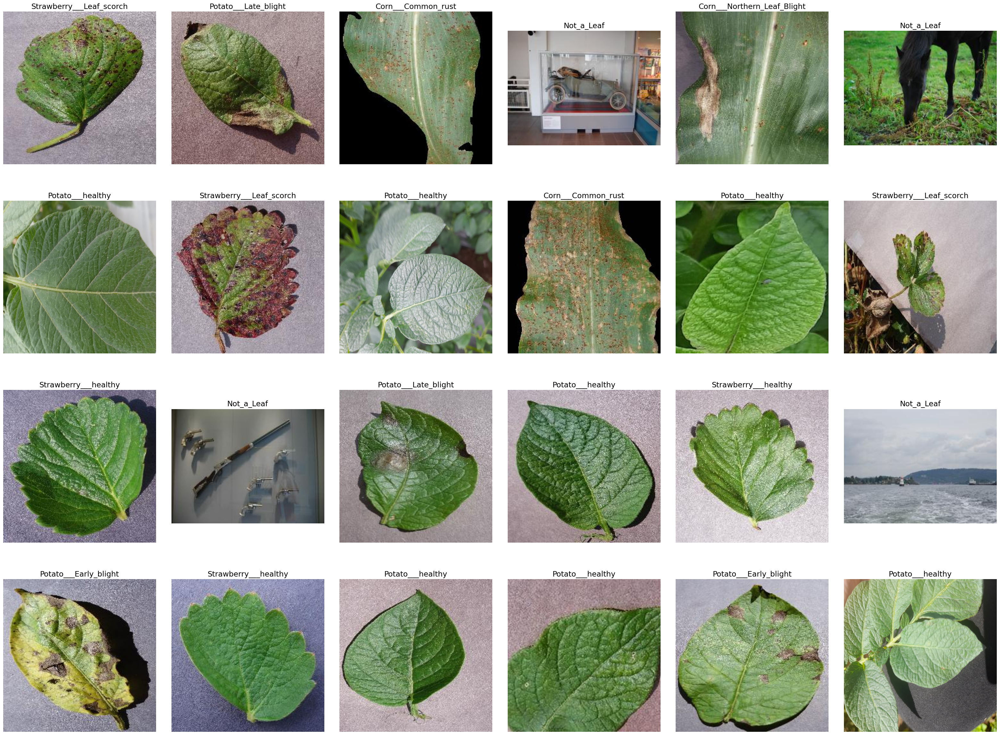

In [ ]:
plt.figure(figsize=(40,30))
plt.subplots_adjust(wspace=0.1, hspace=0.1)

for i in range(24):
    random_folder = np.random.randint(0, len(os.listdir(image_path)))
    random_folder_path = os.path.join(image_path, os.listdir(image_path)[random_folder])
    random_image = np.random.randint(0, len(os.listdir(random_folder_path)))
    random_image_path = os.path.join(random_folder_path, os.listdir(random_folder_path)[random_image])
    image = cv2.imread(random_image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get the class name for the current image
    class_name = class_names[random_folder]

    plt.subplot(4, 6, i + 1)
    plt.imshow(image)
    plt.axis("off")
    plt.title(class_name)

plt.show()

In [ ]:
print("Number of classes : {}".format(len(class_names)))

Number of classes : 9


In [ ]:
numberof_images={}
for class_name in class_names:
    numberof_images[class_name]=len(os.listdir(image_path+"/"+class_name))
images_each_class=pd.DataFrame(numberof_images.values(),index=numberof_images.keys(),columns=["Number of images"])
images_each_class

,Number of images
Strawberry___Leaf_scorch,1069
Strawberry___healthy,1000
Corn___Common_rust,1060
Corn___healthy,1031
Corn___Northern_Leaf_Blight,1031
Not_a_Leaf,1070
Potato___Early_blight,1011
Potato___healthy,1000
Potato___Late_blight,1061


In [ ]:
IMG_WIDTH = 224
IMG_HEIGHT = 224
batch_size=32
num_classes=9

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
train_datagen = ImageDataGenerator(
    rescale=1.0/255,
    zoom_range=0.2,
    width_shift_range=0.2,
    height_shift_range=0.2,
    fill_mode='nearest',
    horizontal_flip=True,
    vertical_flip=True,
    rotation_range=35,
    brightness_range=[0.9, 1.1]
)

train_generator = train_datagen.flow_from_directory(train_image_path,
                                                   target_size=(IMG_WIDTH, IMG_HEIGHT),
                                                   batch_size=batch_size,
                                                   class_mode='sparse',
                                                   color_mode='rgb',
                                                   shuffle=True)

Found 9333 images belonging to 9 classes.


In [ ]:
validation_datagen = ImageDataGenerator(rescale=1.0/255)
validation_generator = validation_datagen.flow_from_directory(valid_image_path,
                                                               target_size=(IMG_WIDTH, IMG_HEIGHT),
                                                               batch_size=batch_size,
                                                               class_mode='sparse',
                                                               color_mode='rgb',
                                                               shuffle=True)


Found 1022 images belonging to 9 classes.


In [ ]:
testdata_generator = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

test_data_generator = testdata_generator.flow_from_directory(test_image_path,
                                                             batch_size=batch_size,
                                                             class_mode='sparse',
                                                             target_size=(IMG_WIDTH, IMG_HEIGHT),
                                                             color_mode='rgb',
                                                             shuffle=False)


Found 998 images belonging to 9 classes.


In [ ]:
train_number=train_generator.samples
valid_number=validation_generator.samples

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Flatten, Dense, Dropout
from tensorflow.keras.applications import ResNet50V2
from tensorflow.keras.optimizers import Adam

def create_resnet50v2_model():
    # Define ResNet50V2 model
    resnet_base = ResNet50V2(weights='imagenet', include_top=False, input_shape=(IMG_WIDTH, IMG_HEIGHT, 3))

    # Freeze the layers of the ResNet base
    for layer in resnet_base.layers:
        layer.trainable = False

    # Add custom top layers
    x = Flatten()(resnet_base.output)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.5)(x)
    output = Dense(9, activation='softmax')(x)  # Output layer with 9 classes

    # Combine base model with custom top layers
    model = Model(inputs=resnet_base.input, outputs=output)

    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

resnet50v2_model = create_resnet50v2_model()

94668760/94668760 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


In [ ]:
resnet50v2_model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_conv[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_bn    │ (None, 56, 56, 64)     │            256 │ pool1_pool[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_relu  │ (None, 56, 56, 64)     │              0 │ conv2_block1_preact_b… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,096 │ conv2_block1_preact_r… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_pad        │ (None, 58, 58, 64)     │              0 │ conv2_block1_1_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,864 │ conv2_block1_2_pad[0]… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_preact_r… │
│ (Conv2D)             

 Total params: 29,987,977 (114.40 MB)

 Trainable params: 6,423,177 (24.50 MB)

 Non-trainable params: 23,564,800 (89.89 MB)

In [ ]:
!pip install pydot==1.4.2
!apt-get install graphviz -y

  Attempting uninstall: pydot
    Found existing installation: pydot 3.0.4
    Uninstalling pydot-3.0.4:
      Successfully uninstalled pydot-3.0.4
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
graphviz is already the newest version (2.42.2-6ubuntu0.1).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(resnet50v2_model, expand_nested=True, show_shapes=True, show_layer_names=False)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.526327 to fit



In [ ]:
# Specify the full path for saving the best model
from tensorflow.keras.callbacks import ModelCheckpoint
model_checkpoint = ModelCheckpoint('/content/drive/MyDrive/PlantProject/best_of_modelResv3.keras', save_best_only=True, monitor='val_loss', mode='min')

In [ ]:
from keras.callbacks import ReduceLROnPlateau

In [ ]:
!env TF_XLA_FLAGS="--tf_xla_auto_jit=0"

SHELL=/bin/bash
COLAB_JUPYTER_TRANSPORT=ipc
TENSORSTORE_CURL_LOW_SPEED_LIMIT_BYTES=256
CGROUP_MEMORY_EVENTS=/sys/fs/cgroup/memory.events /var/colab/cgroup/jupyter-children/memory.events
VM_GCE_METADATA_HOST=169.254.169.253
TPU_WORKER_ID=0
HOSTNAME=17cc3ef0b73b
LANGUAGE=en_US
TBE_RUNTIME_ADDR=172.28.0.1:8011
COLAB_TPU_1VM=1
GCE_METADATA_TIMEOUT=3
TF_CPP_MIN_LOG_LEVEL=1
COLAB_JUPYTER_IP=172.28.0.12
COLAB_LANGUAGE_SERVER_PROXY_ROOT_URL=http://172.28.0.1:8013/
TPU_SKIP_MDS_QUERY=1
KMP_LISTEN_PORT=6000
TF_FORCE_GPU_ALLOW_GROWTH=true
ENV=/root/.bashrc
TENSORSTORE_CURL_LOW_SPEED_TIME_SECONDS=60
PWD=/content
TBE_EPHEM_CREDS_ADDR=172.28.0.1:8009
COLAB_LANGUAGE_SERVER_PROXY_REQUEST_TIMEOUT=30s
TBE_CREDS_ADDR=172.28.0.1:8008
CLOUD_TPU_TASK_ID=0
TPU_CHIPS_PER_HOST_BOUNDS=2,2,1
COLAB_JUPYTER_TOKEN=
LAST_FORCED_REBUILD=20250106
TCLLIBPATH=/usr/share/tcltk/tcllib1.20
COLAB_KERNEL_MANAGER_PROXY_HOST=172.28.0.12
USE_AUTH_EPHEM=1
COLAB_WARMUP_DEFAULTS=1
HOME=/root
LANG=en_US.UTF-8
COLUMNS=100
TPU_ACCELE

In [ ]:
history_resnetv2 = resnet50v2_model.fit(
    train_generator,
    validation_data=validation_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=15,
    validation_steps=validation_generator.samples // batch_size,
    verbose=2,
    callbacks=[
        ReduceLROnPlateau(monitor='val_loss', factor=np.sqrt(0.1), patience=5),
        model_checkpoint  # Save the best model
    ]
)

Epoch 1/15


KeyboardInterrupt: 

In [ ]:
resnet50v2_model.save("/content/drive/MyDrive/NayaProject/square_res_model.keras")

In [ ]:
resnet50v2_model.save("/content/drive/MyDrive/NayaProject/square_res_model.h5")

In [ ]:
# Access metrics from the training history
train_accuracy = history_resnetv2.history['accuracy']
val_accuracy = history_resnetv2.history['val_accuracy']

train_loss = history_resnetv2.history['loss']
val_loss = history_resnetv2.history['val_loss']

# If using a learning rate scheduler (e.g., ReduceLROnPlateau)
learning_rate = history_resnetv2.history['lr']

NameError: name 'history_resnetv2' is not defined

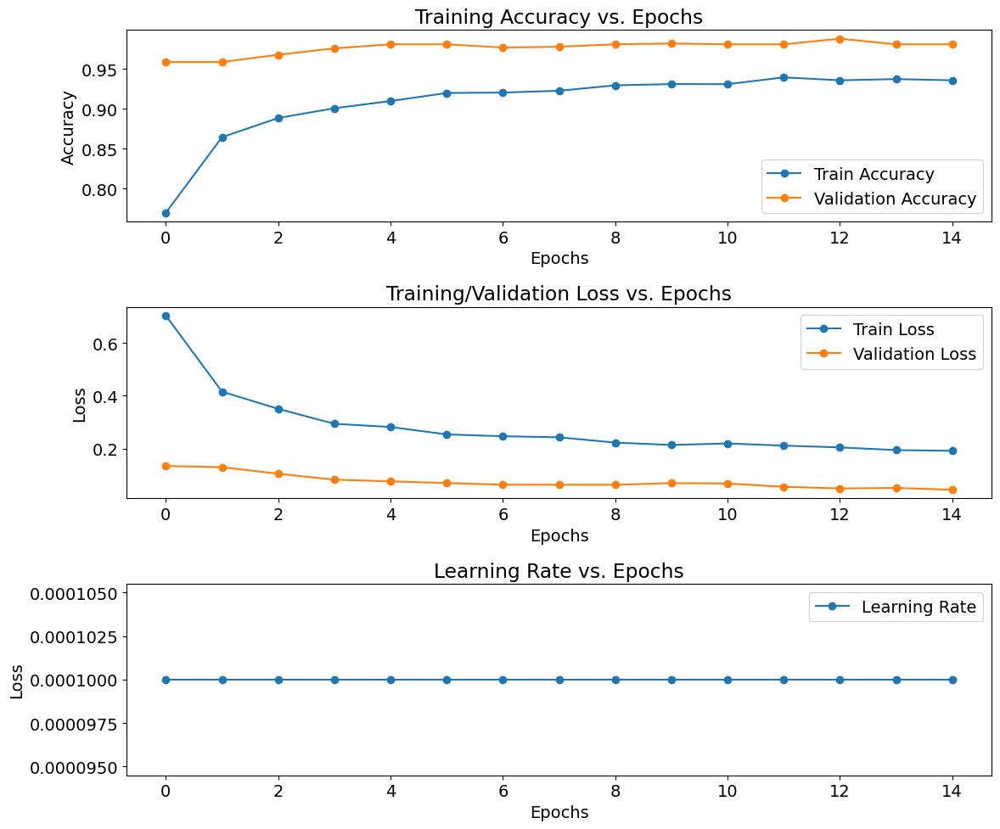

In [ ]:
fig, ax = plt.subplots(nrows=3, ncols=1, figsize=(12, 10))

ax[0].set_title('Training Accuracy vs. Epochs')
ax[0].plot(train_accuracy, 'o-', label='Train Accuracy')
ax[0].plot(val_accuracy, 'o-', label='Validation Accuracy')
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('Accuracy')
ax[0].legend(loc='best')

ax[1].set_title('Training/Validation Loss vs. Epochs')
ax[1].plot(train_loss, 'o-', label='Train Loss')
ax[1].plot(val_loss, 'o-', label='Validation Loss')
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Loss')
ax[1].legend(loc='best')

ax[2].set_title('Learning Rate vs. Epochs')
ax[2].plot(learning_rate, 'o-', label='Learning Rate')
ax[2].set_xlabel('Epochs')
ax[2].set_ylabel('Loss')
ax[2].legend(loc='best')

plt.tight_layout()
plt.show()

In [ ]:
import pickle
# Specify the file path
history_file_path = '/content/drive/MyDrive/NayaProject/training_history.pkl'

# Check if the file exists
if os.path.exists(history_file_path):
    # If the file exists, load the existing history
    with open(history_file_path, 'rb') as file:
        existing_history = pickle.load(file)

    # Merge the existing history with the new history
    for key in existing_history:
        existing_history[key].extend(history_resnetv2.history[key])

    # Save the merged history back to the file
    with open(history_file_path, 'wb') as file:
        pickle.dump(existing_history, file)

    print(f"Training history merged and saved to: {history_file_path}")

else:
    # If the file doesn't exist, save the new history to it
    with open(history_file_path, 'wb') as file:
        pickle.dump(history_resnetv2.history, file)

    print(f"Training history saved to a new file: {history_file_path}")

Training history saved to a new file: /content/drive/MyDrive/NayaProject/training_history.pkl


In [ ]:
# Evaluate the model on the test set
test_loss, test_accuracy = resnet50v2_model.evaluate(test_data_generator, steps=test_data_generator.samples // batch_size, verbose=2)


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


31/31 - 7s - loss: 0.0408 - accuracy: 0.9889 - 7s/epoch - 216ms/step


In [ ]:
print(f"Test Loss:     {test_loss}")
print(f"Test Accuracy: {test_accuracy}")

Test Loss:     0.040828488767147064
Test Accuracy: 0.9889112710952759


In [ ]:
predictions = resnet50v2_model.predict(test_data_generator)

32/32 [==============================] - 8s 219ms/step


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix,f1_score
y_true = test_data_generator.classes
y_pred = np.argmax(predictions, axis=1)

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

# Confusion Matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Print the computed metrics
print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")
print(f"Confusion Matrix:\n{conf_matrix}")

Accuracy: 0.9889779559118237
Precision: 0.9890834299412198
Recall: 0.9889779559118237
F1 Score: 0.9889499128349449
Confusion Matrix:
[[120   0   0   0   0   0   0   0   0]
 [  0 109   0   0   0   0   0   0   0]
 [  0   0 109   0   0   0   0   0   0]
 [  0   2   1 118   0   0   0   1   0]
 [  0   0   0   0 109   0   0   0   0]
 [  0   0   0   0   1 107   1   0   0]
 [  0   0   0   0   0   4  96   0   0]
 [  0   0   0   0   0   0   0 119   1]
 [  0   0   0   0   0   0   0   0 100]]


In [ ]:
labels = {value: key for key, value in train_generator.class_indices.items()}

print("Label Mappings for classes present in the training and validation datasets\n")
for key, value in labels.items():
    print(f"{key} : {value}")

Label Mappings for classes present in the training and validation datasets

0 : Corn___Common_rust
1 : Corn___Northern_Leaf_Blight
2 : Corn___healthy
3 : Not_a_Leaf
4 : Potato___Early_blight
5 : Potato___Late_blight
6 : Potato___healthy
7 : Strawberry___Leaf_scorch
8 : Strawberry___healthy


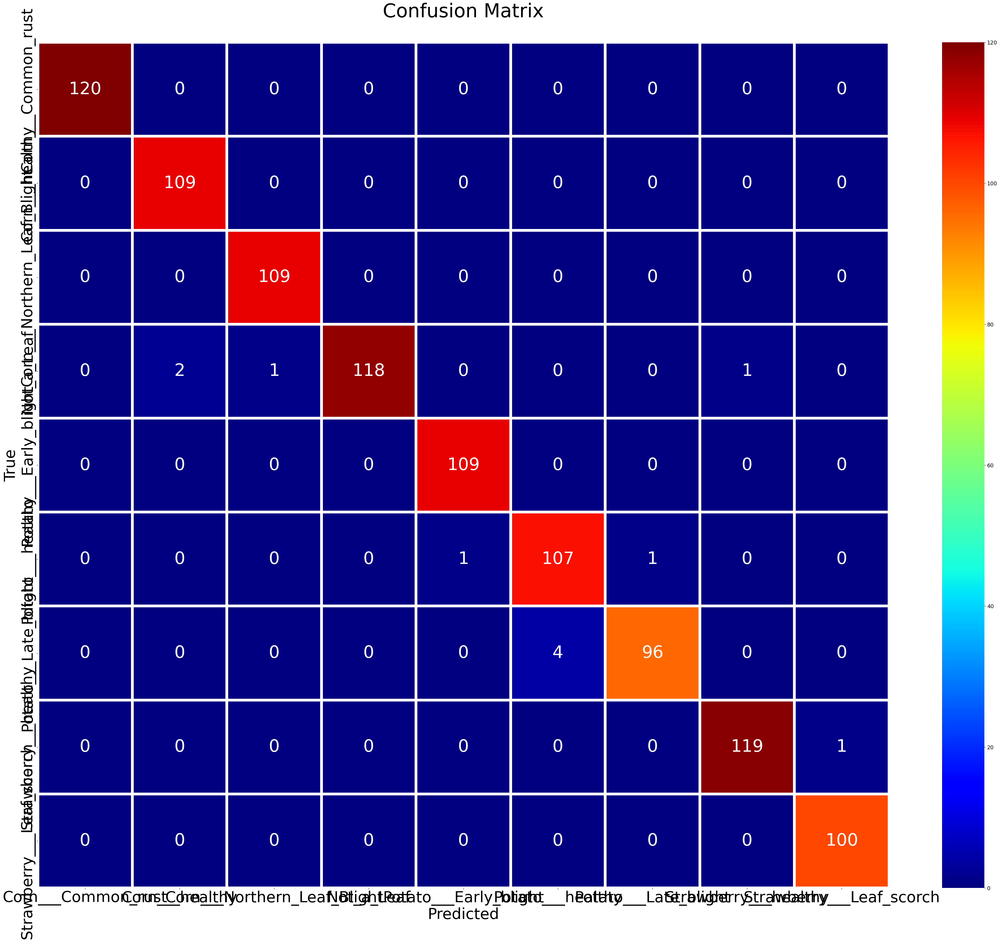

In [ ]:
plt.figure(figsize=(50,40))
confusion = confusion_matrix(y_true, y_pred)
sns.heatmap(confusion, annot=True, fmt='d', cmap='jet',xticklabels=class_names,
            yticklabels=class_names,lw=6,annot_kws={"size": 45})
plt.xlabel('Predicted',fontsize=40,color="black")
plt.ylabel('True',fontsize=40,color="black")
plt.title('Confusion Matrix\n',fontsize=50,color="black")
# Adjust the class names font size
plt.xticks(fontsize=40)
plt.yticks(fontsize=40)
plt.show()

In [ ]:
print(classification_report(y_true, y_pred, target_names=labels.values()))

                             precision    recall  f1-score   support

         Corn___Common_rust       1.00      1.00      1.00       120
Corn___Northern_Leaf_Blight       0.98      1.00      0.99       109
             Corn___healthy       0.99      1.00      1.00       109
                 Not_a_Leaf       1.00      0.97      0.98       122
      Potato___Early_blight       0.99      1.00      1.00       109
       Potato___Late_blight       0.96      0.98      0.97       109
           Potato___healthy       0.99      0.96      0.97       100
   Strawberry___Leaf_scorch       0.99      0.99      0.99       120
       Strawberry___healthy       0.99      1.00      1.00       100

                   accuracy                           0.99       998
                  macro avg       0.99      0.99      0.99       998
               weighted avg       0.99      0.99      0.99       998



In [ ]:
# Generate classification report
report = classification_report(y_true, y_pred, target_names=labels.values(), output_dict=True)

# Convert classification report to DataFrame
report_df = pd.DataFrame(report).transpose()

# Set border for DataFrame cells
styles = [
    dict(selector="td", props=[("border", "1px solid black")]),
    dict(selector="th", props=[("border", "1px solid black")])
]

# Apply border styles to the DataFrame
styled_report_df = report_df.style.set_table_styles(styles)

# Display the styled DataFrame
styled_report_df


,precision,recall,f1-score,support
Corn___Common_rust,1.000000,1.000000,1.000000,120.000000
Corn___Northern_Leaf_Blight,0.981982,1.000000,0.990909,109.000000
Corn___healthy,0.990909,1.000000,0.995434,109.000000
Not_a_Leaf,1.000000,0.967213,0.983333,122.000000
Potato___Early_blight,0.990909,1.000000,0.995434,109.000000
Potato___Late_blight,0.963964,0.981651,0.972727,109.000000
Potato___healthy,0.989691,0.960000,0.974619,100.000000
Strawberry___Leaf_scorch,0.991667,0.991667,0.991667,120.000000
Strawberry___healthy,0.990099,1.000000,0.995025,100.000000
accuracy,0.988978,0.988978,0.988978,0.988978


15/32 [=============>................] - ETA: 2s

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


32/32 [==============================] - 5s 161ms/step


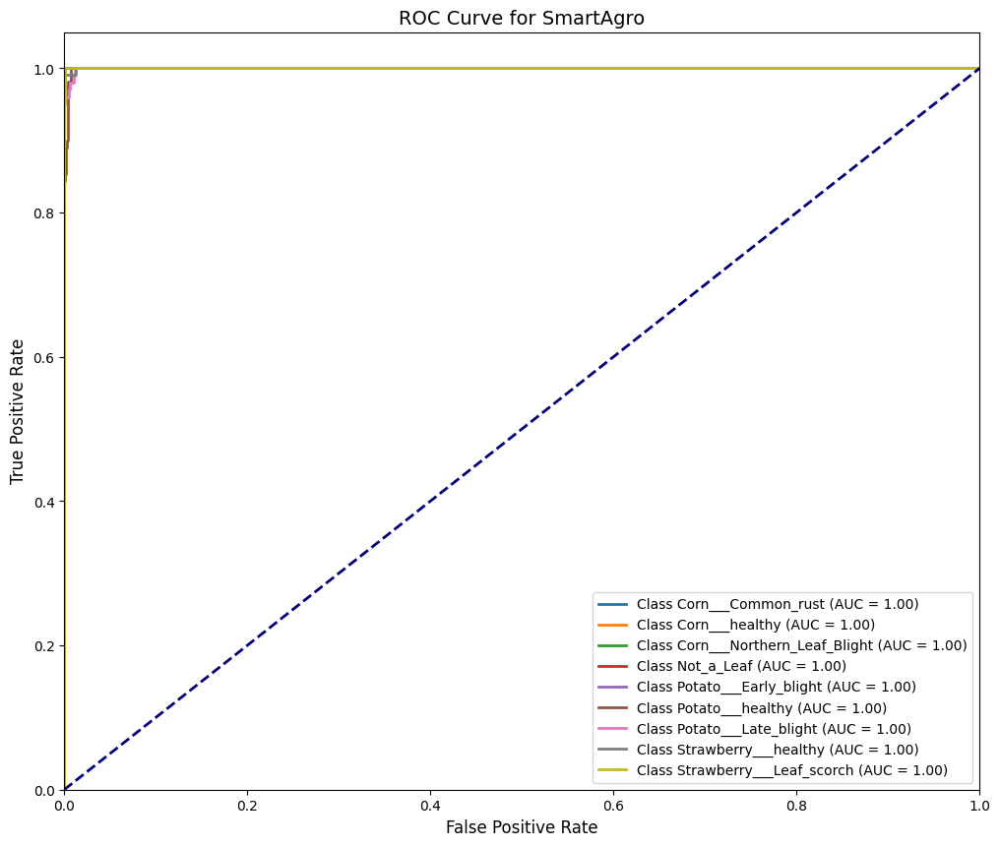

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# Assuming you already have predictions, y_true, and class_names defined
predictions = resnet50v2_model.predict(test_data_generator)
y_true = test_data_generator.classes


# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(num_classes):  # num_classes is the number of classes
    fpr[i], tpr[i], _ = roc_curve(y_true, predictions[:, i], pos_label=i)
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve for each class
plt.figure(figsize=(12, 10))
for i in range(num_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label=f'Class {class_names[i]} (AUC = {roc_auc[i]:0.2f})')

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate', fontsize=12)
plt.ylabel('True Positive Rate', fontsize=12)
plt.title('ROC Curve for SmartAgro', fontsize=14)
plt.legend(loc="lower right", fontsize=10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.show()


In [39]:
from tensorflow.keras.models import load_model

loaded_model = load_model("/content/drive/MyDrive/PlantProject/best_of_modelResv2nice.h5")

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


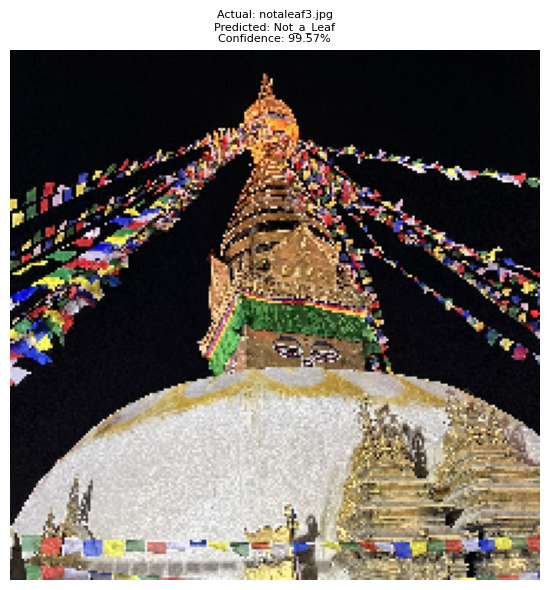

In [40]:
import matplotlib.pyplot as plt
import os
import numpy as np
from keras.preprocessing import image

# Calculate the number of rows and columns for the subplot grid
num_rows = 1
num_cols = 1

# Calculate the figure size based on the original image aspect ratio
fig_width = 8
fig_height = 6

# Create a subplot grid for the image
fig, axes = plt.subplots(num_rows, num_cols, figsize=(fig_width, fig_height))
fig.subplots_adjust(wspace=0.5, hspace=0.5)  # Adjust horizontal and vertical spacing

# Specify the path to the image you want to predict
specific_image_path = "/content/drive/MyDrive/PlantProject/PlantDatavgg/realtimetest/Not_a_Leaf/notaleaf3.jpg"


#specific_image_path = "/content/drive/MyDrive/Project/pLB.jpg"

# Extract actual class name from the file name (assuming the file name structure is known)
actual_class_name = os.path.basename(specific_image_path).split("_")[0]  # Adjust based on your file naming convention

# Load and preprocess the specified image
specific_image = image.load_img(specific_image_path, target_size=(IMG_WIDTH, IMG_HEIGHT))
specific_image_array = image.img_to_array(specific_image)
specific_image_array = np.expand_dims(specific_image_array, axis=0)
specific_image_array /= 255.0

# Predict the class of the specified image using the loaded model
prediction = loaded_model.predict(specific_image_array)
predicted_class_index = np.argmax(prediction)
predicted_class_name = labels[predicted_class_index]
confidence_percentage = prediction[0, predicted_class_index] * 100

# Display the specified image with actual and predicted class names
axes.imshow(specific_image)
axes.set_title(f"Actual: {actual_class_name}\nPredicted: {predicted_class_name}\nConfidence: {confidence_percentage:.2f}%", fontsize=8)
axes.axis("off")

# Adjust the layout and show the plot
plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Streaming output truncated to the last 5000 lines.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━

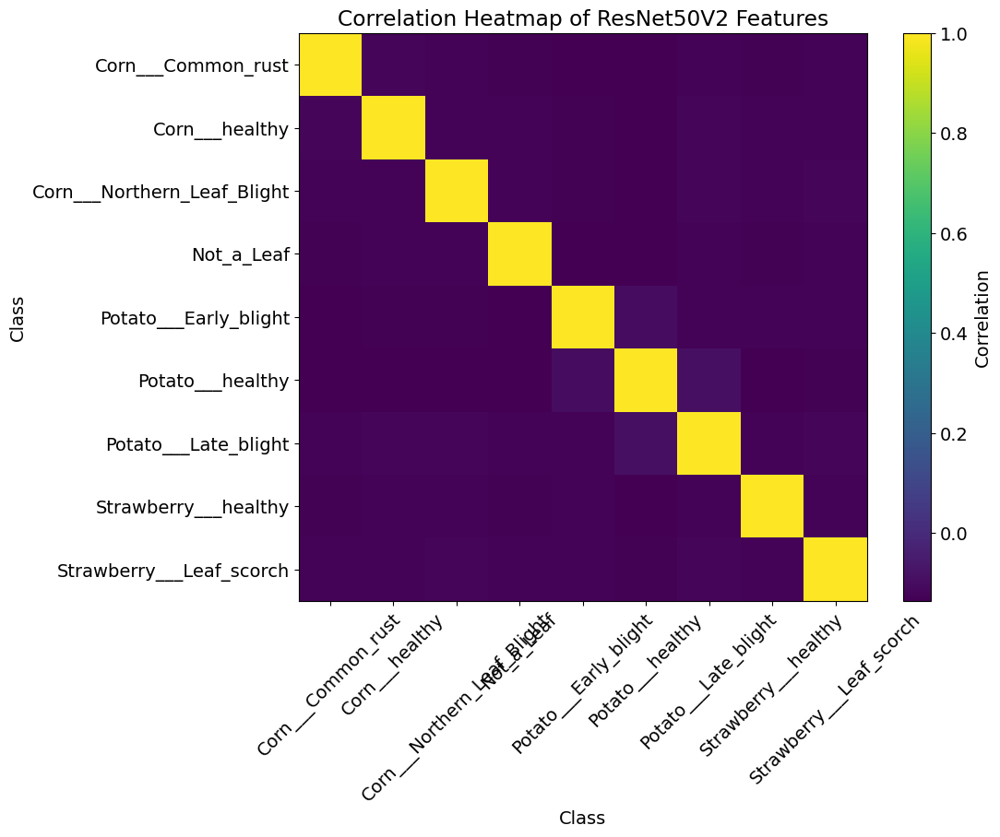

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet_v2 import preprocess_input
from sklearn.metrics import pairwise_distances


class_directories = os.listdir(train_image_path)

class_labels = []
features = []

def extract_features_batch(image_paths, model):
    batch_features = []
    for image_path in image_paths:
        img = image.load_img(image_path, target_size=(224, 224))
        img_array = image.img_to_array(img)
        img_array = np.expand_dims(img_array, axis=0)
        img_array = preprocess_input(img_array)  # Preprocess the input image
        feature = model.predict(img_array)
        batch_features.append(feature.flatten())
    return np.array(batch_features)

for class_index, class_dir in enumerate(class_directories):
    class_path = os.path.join(train_image_path, class_dir)
    image_filenames = os.listdir(class_path)
    batch_size = 50  # Adjust batch size according to your system's memory capacity
    for i in range(0, len(image_filenames), batch_size):
        batch_image_paths = [os.path.join(class_path, filename) for filename in image_filenames[i:i+batch_size]]
        batch_features = extract_features_batch(batch_image_paths, resnet50v2_model)
        features.extend(batch_features)
        class_labels.extend([class_index] * len(batch_features))

features = np.array(features)

# Compute the correlation matrix
correlation_matrix = np.corrcoef(features, rowvar=False)

# Visualize the correlation heatmap with class labels
plt.figure(figsize=(10, 8))
plt.imshow(correlation_matrix, cmap='viridis', interpolation='nearest')

# Add class labels to both axes
plt.xticks(ticks=np.arange(len(class_directories)), labels=class_directories, rotation=45)
plt.yticks(ticks=np.arange(len(class_directories)), labels=class_directories)
plt.colorbar(label='Correlation')
plt.title('Correlation Heatmap of ResNet50V2 Features')
plt.xlabel('Class')
plt.ylabel('Class')
plt.show()

In [ ]:
from tensorflow.keras.models import load_model

loaded_resmodel = load_model("/content/drive/MyDrive/PlantProject/best_of_modelResv2nice.h5")

In [ ]:
realtimetest= "/content/drive/MyDrive/PlantProject/PlantDatavgg/realtimetest/"


In [ ]:
realtestdata_generator = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)
realtest_data_generator = realtestdata_generator.flow_from_directory(realtimetest,
                                                             batch_size=batch_size,
                                                             class_mode='sparse',
                                                             target_size=(IMG_WIDTH, IMG_HEIGHT),
                                                             color_mode='rgb',
                                                             shuffle=False)


Found 41 images belonging to 9 classes.


In [ ]:
labels = {value: key for key, value in train_generator.class_indices.items()}

print("Label Mappings for classes present in the training and validation datasets\n")
for key, value in labels.items():
    print(f"{key} : {value}")

Label Mappings for classes present in the training and validation datasets

0 : Corn___Common_rust
1 : Corn___Northern_Leaf_Blight
2 : Corn___healthy
3 : Not_a_Leaf
4 : Potato___Early_blight
5 : Potato___Late_blight
6 : Potato___healthy
7 : Strawberry___Leaf_scorch
8 : Strawberry___healthy


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


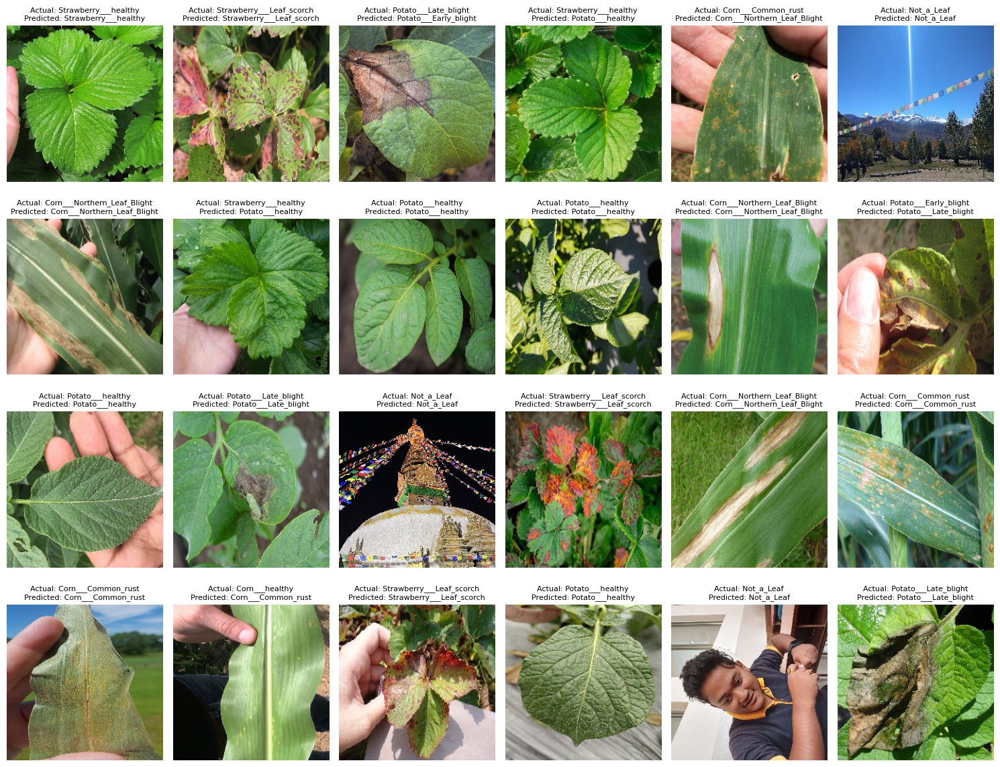

In [ ]:
import random
image_files = []
for root, dirs, files in os.walk(realtimetest):
    for file in files:
        if file.startswith('.') or os.path.isdir(os.path.join(root, file)):  # Skip hidden files and directories
            continue
        image_files.append(os.path.join(root, file))

# Shuffle the image files
random.shuffle(image_files)

# Take the first 24 images if available, or all images if less than 18
num_images = min(24, len(image_files))
image_files = image_files[:num_images]

# Calculate the number of rows and columns for the subplot grid
num_rows = 4
num_cols = 6
# Create a subplot grid for the images
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15,12))
fig.subplots_adjust(wspace=0.5, hspace=0.2)  # Adjust horizontal and vertical spacing

for i, image_path in enumerate(image_files):
    # Load and preprocess the image
    image_obj = image.load_img(image_path, target_size=(IMG_WIDTH, IMG_HEIGHT))
    image_array = image.img_to_array(image_obj)
    image_array = np.expand_dims(image_array, axis=0)
    image_array /= 255.0

    # Predict the class of the image using the loaded model
    prediction = loaded_resmodel.predict(image_array)
    predicted_class_index = np.argmax(prediction)
    predicted_class_name = labels[predicted_class_index]
    #confidence_percentage = prediction[0, predicted_class_index] * 100

    # Extract actual class name from the folder name
    actual_class_name = os.path.basename(os.path.dirname(image_path))

    # Display the image with actual and predicted class names
    row_index = i // num_cols
    col_index = i % num_cols

    axes[row_index, col_index].imshow(image_obj)
    axes[row_index, col_index].set_title(f"Actual: {actual_class_name}\nPredicted: {predicted_class_name}", fontsize=8)
    axes[row_index, col_index].axis("off")

# Adjust the layout and show the plot
plt.tight_layout()
plt.show()

In [ ]:
# Evaluate the model on the test set
test_loss, test_accuracy = loaded_resmodel.evaluate(realtest_data_generator)

2/2 [==============================] - 9s 1s/step - loss: 0.8725 - accuracy: 0.8537


In [ ]:
print(f"Test Loss:     {test_loss}")
print(f"Test Accuracy: {test_accuracy}")

Test Loss:     0.8725217580795288
Test Accuracy: 0.8536585569381714


In [ ]:
realpredictions = loaded_resmodel.predict(realtest_data_generator)

2/2 [==============================] - 8s 2s/step


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix,f1_score
y_true = realtest_data_generator.classes
y_pred = np.argmax(realpredictions, axis=1)

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

# Confusion Matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Print the computed metrics
print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")
print(f"Confusion Matrix:\n{conf_matrix}")

Accuracy: 0.8536585365853658
Precision: 0.8716608594657376
Recall: 0.8536585365853658
F1 Score: 0.8509925034315279
Confusion Matrix:
[[4 1 0 0 0 0 0 0 0]
 [0 5 0 0 0 0 0 0 0]
 [1 0 3 0 0 0 0 0 0]
 [0 0 0 5 0 0 0 0 0]
 [0 0 0 0 3 1 0 0 0]
 [0 0 0 0 1 3 0 0 0]
 [0 0 0 0 0 0 5 0 0]
 [0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 2 0 3]]


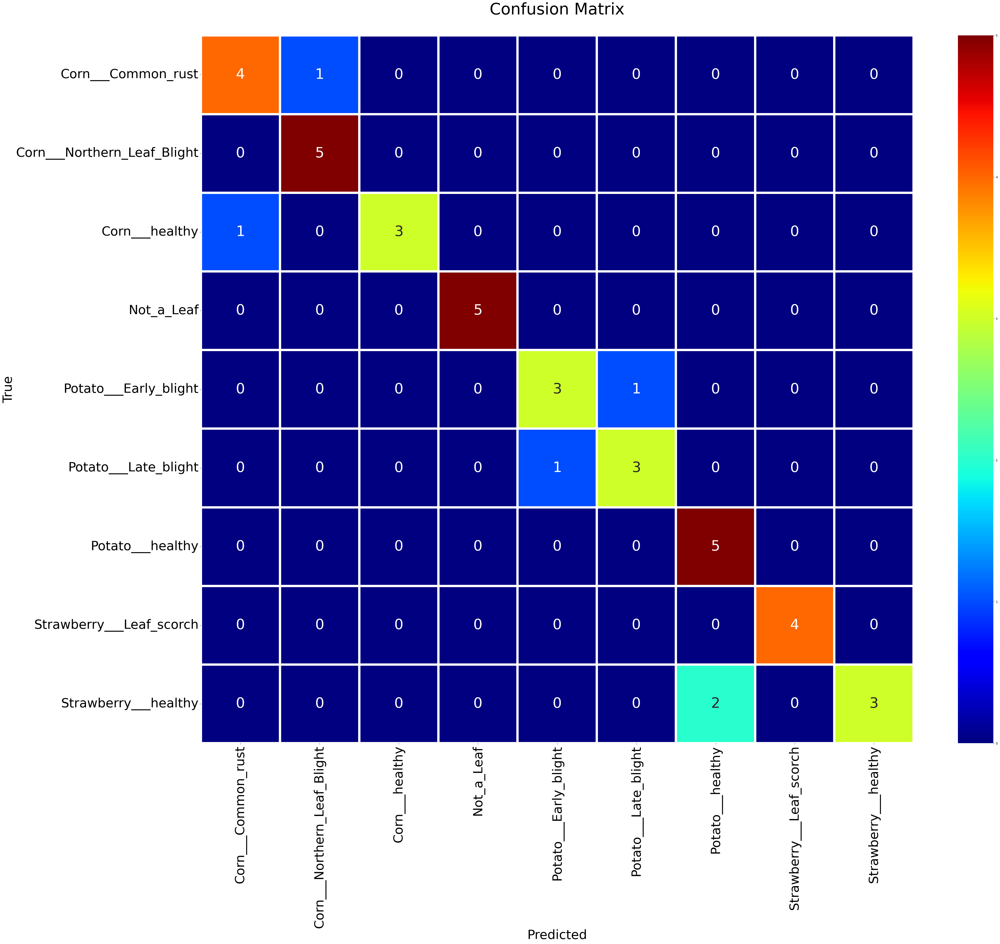

In [ ]:
plt.figure(figsize=(50,40))
confusion = confusion_matrix(y_true, y_pred)

sns.heatmap(confusion, annot=True, fmt='d', cmap='jet', xticklabels=[labels[i] for i in range(len(labels))],
            yticklabels=[labels[i] for i in range(len(labels))], lw=6, annot_kws={"size": 45})
plt.xlabel('Predicted', fontsize=40, color="black")
plt.ylabel('True', fontsize=40, color="black")
plt.title('Confusion Matrix\n', fontsize=50, color="black")

plt.xticks(fontsize=40, rotation=90, color="black")
plt.yticks(fontsize=40, rotation=0, color="black")
plt.show()

In [ ]:
print(classification_report(y_true, y_pred,target_names=[labels[i] for i in range(len(labels))]))

                             precision    recall  f1-score   support

         Corn___Common_rust       0.80      0.80      0.80         5
Corn___Northern_Leaf_Blight       0.83      1.00      0.91         5
             Corn___healthy       1.00      0.75      0.86         4
                 Not_a_Leaf       1.00      1.00      1.00         5
      Potato___Early_blight       0.75      0.75      0.75         4
       Potato___Late_blight       0.75      0.75      0.75         4
           Potato___healthy       0.71      1.00      0.83         5
   Strawberry___Leaf_scorch       1.00      1.00      1.00         4
       Strawberry___healthy       1.00      0.60      0.75         5

                   accuracy                           0.85        41
                  macro avg       0.87      0.85      0.85        41
               weighted avg       0.87      0.85      0.85        41



In [ ]:
# Generate classification report
report = classification_report(y_true, y_pred, target_names=labels.values(), output_dict=True)

# Convert classification report to DataFrame
report_df = pd.DataFrame(report).transpose()

# Set border for DataFrame cells
styles = [
    dict(selector="td", props=[("border", "1px solid black")]),
    dict(selector="th", props=[("border", "1px solid black")])
]

# Apply border styles to the DataFrame
styled_report_df = report_df.style.set_table_styles(styles)

# Display the styled DataFrame
styled_report_df


,precision,recall,f1-score,support
Corn___Common_rust,0.800000,0.800000,0.800000,5.000000
Corn___Northern_Leaf_Blight,0.833333,1.000000,0.909091,5.000000
Corn___healthy,1.000000,0.750000,0.857143,4.000000
Not_a_Leaf,1.000000,1.000000,1.000000,5.000000
Potato___Early_blight,0.750000,0.750000,0.750000,4.000000
Potato___Late_blight,0.750000,0.750000,0.750000,4.000000
Potato___healthy,0.714286,1.000000,0.833333,5.000000
Strawberry___Leaf_scorch,1.000000,1.000000,1.000000,4.000000
Strawberry___healthy,1.000000,0.600000,0.750000,5.000000
accuracy,0.853659,0.853659,0.853659,0.853659


2/2 [==============================] - 7s 1s/step


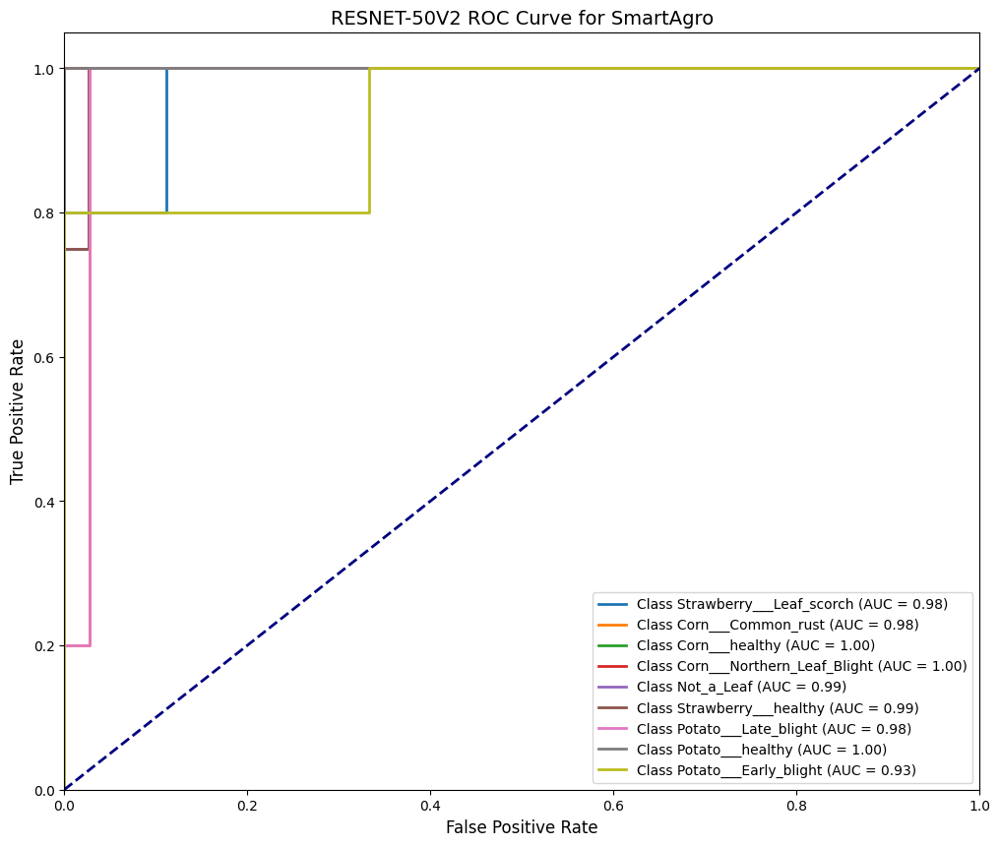

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# Assuming you already have predictions, y_true, and class_names defined
realpredictions = loaded_resmodel.predict(realtest_data_generator)
y_true = realtest_data_generator.classes
num_classes = len(class_names)

# Compute ROC curve and ROC area for each class
plt.figure(figsize=(12, 10))
for i in range(num_classes):
    fpr, tpr, _ = roc_curve(y_true, realpredictions[:, i], pos_label=i)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, lw=2, label=f'Class {class_names[i]} (AUC = {roc_auc:0.2f})')

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate', fontsize=12)
plt.ylabel('True Positive Rate', fontsize=12)
plt.title('RESNET-50V2 ROC Curve for SmartAgro', fontsize=14)
plt.legend(loc="lower right", fontsize=10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


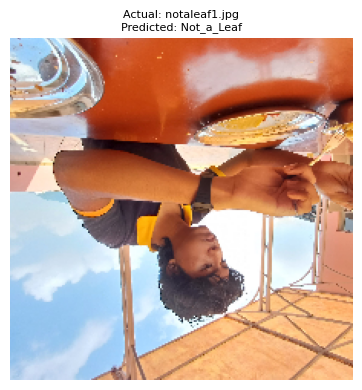

In [42]:
import matplotlib.pyplot as plt
import os
import numpy as np
from keras.preprocessing import image

# Calculate the number of rows and columns for the subplot grid
num_rows = 1
num_cols = 1

# Calculate the figure size based on the original image aspect ratio
fig_width = 4
fig_height = 4

# Create a subplot grid for the image
fig, axes = plt.subplots(num_rows, num_cols, figsize=(fig_width, fig_height))
fig.subplots_adjust(wspace=0.5, hspace=0.5)  # Adjust horizontal and vertical spacing

# Specify the path to the image you want to predict
specific_image_path = "/content/drive/MyDrive/PlantProject/PlantDatavgg/realtimetest/Not_a_Leaf/notaleaf1.jpg"


# Extract actual class name from the file name (assuming the file name structure is known)
actual_class_name = os.path.basename(specific_image_path).split("_")[0]  # Adjust based on your file naming convention

# Load and preprocess the specified image
specific_image = image.load_img(specific_image_path, target_size=(IMG_WIDTH, IMG_HEIGHT))
specific_image_array = image.img_to_array(specific_image)
specific_image_array = np.expand_dims(specific_image_array, axis=0)
specific_image_array /= 255.0

# Predict the class of the specified image using the loaded model
prediction = loaded_resmodel.predict(specific_image_array)
predicted_class_index = np.argmax(prediction)
predicted_class_name = labels[predicted_class_index]
confidence_percentage = prediction[0, predicted_class_index] * 100

# Display the specified image with actual and predicted class names
axes.imshow(specific_image)
axes.set_title(f"Actual: {actual_class_name}\nPredicted: {predicted_class_name}", fontsize=8)
axes.axis("off")

# Adjust the layout and show the plot
plt.tight_layout()
plt.show()